In [1]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px

import pandas as pd  
import seaborn as sns 

from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge, Lasso 
from sklearn.neural_network import MLPRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression

from sklearn.metrics import r2_score, mean_squared_error 
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder

In [2]:
df = pd.read_csv("AB_NYC_2019.csv")

df

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,NaN,NaN,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,NaN,NaN,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,NaN,NaN,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,NaN,NaN,6,2


In [3]:
df = df.drop(["id", "name", "host_id", "host_name", "last_review"], axis=1)

df.head()

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365
1,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355
2,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1,365
3,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,1,194
4,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0


In [4]:
df.corr()

,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
latitude,1.000000,0.084788,0.033939,0.024869,-0.015389,-0.010142,0.019517,-0.010983
longitude,0.084788,1.000000,-0.150019,-0.062747,0.059094,0.145948,-0.114713,0.082731
price,0.033939,-0.150019,1.000000,0.042799,-0.047954,-0.030608,0.057472,0.081829
minimum_nights,0.024869,-0.062747,0.042799,1.000000,-0.080116,-0.121702,0.127960,0.144303
number_of_reviews,-0.015389,0.059094,-0.047954,-0.080116,1.000000,0.549868,-0.072376,0.172028
reviews_per_month,-0.010142,0.145948,-0.030608,-0.121702,0.549868,1.000000,-0.009421,0.185791
calculated_host_listings_count,0.019517,-0.114713,0.057472,0.127960,-0.072376,-0.009421,1.000000,0.225701
availability_365,-0.010983,0.082731,0.081829,0.144303,0.172028,0.185791,0.225701,1.000000


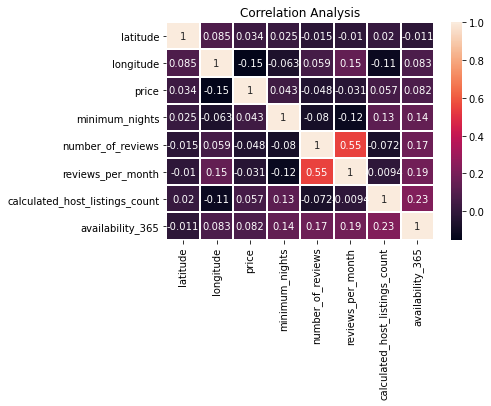

In [5]:
heat_map = sns.heatmap(df.corr(), linewidth = 1 , annot = True)
plt.title("Correlation Analysis" )
plt.show()

In [6]:
#OneHot encoder of Neighbourhood_group feature
oneHot = OneHotEncoder(sparse=False)
encoded_df = oneHot.fit_transform(df["neighbourhood_group"].values.reshape(-1, 1))

neigh_group = pd.DataFrame(encoded_df, columns=oneHot.get_feature_names())
neigh_group.columns = ["neigh_group_Bronx", "neigh_group_Brooklyn", "neigh_group_Manhattan", "neigh_group_Queens", "neigh_group_Staten Island"]
neigh_group


,neigh_group_Bronx,neigh_group_Brooklyn,neigh_group_Manhattan,neigh_group_Queens,neigh_group_Staten Island
0,0.0,1.0,0.0,0.0,0.0
1,0.0,0.0,1.0,0.0,0.0
2,0.0,0.0,1.0,0.0,0.0
3,0.0,1.0,0.0,0.0,0.0
4,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...
48890,0.0,1.0,0.0,0.0,0.0
48891,0.0,1.0,0.0,0.0,0.0
48892,0.0,0.0,1.0,0.0,0.0
48893,0.0,0.0,1.0,0.0,0.0


In [7]:
#Onehot Encoder of neighbourhood feature 
encoded_df = oneHot.fit_transform(df["neighbourhood"].values.reshape(-1, 1))

neigh = pd.DataFrame(encoded_df, columns=oneHot.get_feature_names())
'''for i in neigh.columns:
    i.replace("", "x0")'''
#neigh.columns = "neigh" + neigh.columns
for i in neigh.columns:
    d = i
    i = i.replace("x0", "")
    neigh.rename(columns={d: i}, inplace=True)
neigh.columns = 'neigh' + neigh.columns
neigh

,neigh_Allerton,neigh_Arden Heights,neigh_Arrochar,neigh_Arverne,neigh_Astoria,neigh_Bath Beach,neigh_Battery Park City,neigh_Bay Ridge,neigh_Bay Terrace,"neigh_Bay Terrace, Staten Island",...,neigh_Westerleigh,neigh_Whitestone,neigh_Williamsbridge,neigh_Williamsburg,neigh_Willowbrook,neigh_Windsor Terrace,neigh_Woodhaven,neigh_Woodlawn,neigh_Woodrow,neigh_Woodside
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48891,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48892,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
48893,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
#OneHot encoder of room_type feature 
encoded_df = oneHot.fit_transform(df["room_type"].values.reshape(-1, 1))

room = pd.DataFrame(encoded_df, columns=oneHot.get_feature_names())
#neigh_group.columns = ["neigh_group_Bronx", "neigh_group_Brooklyn", "neigh_group_Manhattan", "neigh_group_Queens", "neigh_group_Staten Island"]
room.columns = ["Entire home/apt", "Private room", "Shared room"]
room

,Entire home/apt,Private room,Shared room
0,0.0,1.0,0.0
1,1.0,0.0,0.0
2,0.0,1.0,0.0
3,1.0,0.0,0.0
4,1.0,0.0,0.0
...,...,...,...
48890,0.0,1.0,0.0
48891,0.0,1.0,0.0
48892,1.0,0.0,0.0
48893,0.0,0.0,1.0


In [9]:
df = df.drop(["neighbourhood_group", "neighbourhood", "room_type", "calculated_host_listings_count"], axis=1)
df = df.join(neigh_group).join(neigh).join(room)
df["reviews_per_month"] = df["reviews_per_month"].fillna(0)
df

,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365,neigh_group_Bronx,neigh_group_Brooklyn,neigh_group_Manhattan,...,neigh_Williamsburg,neigh_Willowbrook,neigh_Windsor Terrace,neigh_Woodhaven,neigh_Woodlawn,neigh_Woodrow,neigh_Woodside,Entire home/apt,Private room,Shared room
0,40.64749,-73.97237,149,1,9,0.21,365,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,40.75362,-73.98377,225,1,45,0.38,355,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,40.80902,-73.94190,150,3,0,0.00,365,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,40.68514,-73.95976,89,1,270,4.64,194,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,40.79851,-73.94399,80,10,9,0.10,0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,40.67853,-73.94995,70,2,0,0.00,9,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
48891,40.70184,-73.93317,40,4,0,0.00,36,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
48892,40.81475,-73.94867,115,10,0,0.00,27,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
48893,40.75751,-73.99112,55,1,0,0.00,2,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [10]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

df.corr()

,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365,neigh_group_Bronx,neigh_group_Brooklyn,neigh_group_Manhattan,neigh_group_Queens,neigh_group_Staten Island,neigh_Allerton,neigh_Arden Heights,neigh_Arrochar,neigh_Arverne,neigh_Astoria,neigh_Bath Beach,neigh_Battery Park City,neigh_Bay Ridge,neigh_Bay Terrace,"neigh_Bay Terrace, Staten Island",neigh_Baychester,neigh_Bayside,neigh_Bayswater,neigh_Bedford-Stuyvesant,neigh_Belle Harbor,neigh_Bellerose,neigh_Belmont,neigh_Bensonhurst,neigh_Bergen Beach,neigh_Boerum Hill,neigh_Borough Park,neigh_Breezy Point,neigh_Briarwood,neigh_Brighton Beach,neigh_Bronxdale,neigh_Brooklyn Heights,neigh_Brownsville,neigh_Bull's Head,neigh_Bushwick,neigh_Cambria Heights,neigh_Canarsie,neigh_Carroll Gardens,neigh_Castle Hill,neigh_Castleton Corners,neigh_Chelsea,neigh_Chinatown,neigh_City Island,neigh_Civic Center,neigh_Claremont Village,neigh_Clason Point,neigh_Clifton,neigh_Clinton Hill,neigh_Co-op City,neigh_Cobble Hill,neigh_College Point,neigh_Columbia St,neigh_Concord,neigh_Concourse,neigh_Concourse Village,neigh_Coney Island,neigh_Corona,neigh_Crown Heights,neigh_Cypress Hills,neigh_DUMBO,neigh_Ditmars Steinway,neigh_Dongan Hills,neigh_Douglaston,neigh_Downtown Brooklyn,neigh_Dyker Heights,neigh_East Elmhurst,neigh_East Flatbush,neigh_East Harlem,neigh_East Morrisania,neigh_East New York,neigh_East Village,neigh_Eastchester,neigh_Edenwald,neigh_Edgemere,neigh_Elmhurst,neigh_Eltingville,neigh_Emerson Hill,neigh_Far Rockaway,neigh_Fieldston,neigh_Financial District,neigh_Flatbush,neigh_Flatiron District,neigh_Flatlands,neigh_Flushing,neigh_Fordham,neigh_Forest Hills,neigh_Fort Greene,neigh_Fort Hamilton,neigh_Fort Wadsworth,neigh_Fresh Meadows,neigh_Glendale,neigh_Gowanus,neigh_Gramercy,neigh_Graniteville,neigh_Grant City,neigh_Gravesend,neigh_Great Kills,neigh_Greenpoint,neigh_Greenwich Village,neigh_Grymes Hill,neigh_Harlem,neigh_Hell's Kitchen,neigh_Highbridge,neigh_Hollis,neigh_Holliswood,neigh_Howard Beach,neigh_Howland Hook,neigh_Huguenot,neigh_Hunts Point,neigh_Inwood,neigh_Jackson Heights,neigh_Jamaica,neigh_Jamaica Estates,neigh_Jamaica Hills,neigh_Kensington,neigh_Kew Gardens,neigh_Kew Gardens Hills,neigh_Kingsbridge,neigh_Kips Bay,neigh_Laurelton,neigh_Lighthouse Hill,neigh_Little Italy,neigh_Little Neck,neigh_Long Island City,neigh_Longwood,neigh_Lower East Side,neigh_Manhattan Beach,neigh_Marble Hill,neigh_Mariners Harbor,neigh_Maspeth,neigh_Melrose,neigh_Middle Village,neigh_Midland Beach,neigh_Midtown,neigh_Midwood,neigh_Mill Basin,neigh_Morningside Heights,neigh_Morris Heights,neigh_Morris Park,neigh_Morrisania,neigh_Mott Haven,neigh_Mount Eden,neigh_Mount Hope,neigh_Murray Hill,neigh_Navy Yard,neigh_Neponsit,neigh_New Brighton,neigh_New Dorp,neigh_New Dorp Beach,neigh_New Springville,neigh_NoHo,neigh_Nolita,neigh_North Riverdale,neigh_Norwood,neigh_Oakwood,neigh_Olinville,neigh_Ozone Park,neigh_Park Slope,neigh_Parkchester,neigh_Pelham Bay,neigh_Pelham Gardens,neigh_Port Morris,neigh_Port Richmond,neigh_Prince's Bay,neigh_Prospect Heights,neigh_Prospect-Lefferts Gardens,neigh_Queens Village,neigh_Randall Manor,neigh_Red Hook,neigh_Rego Park,neigh_Richmond Hill,neigh_Richmondtown,neigh_Ridgewood,neigh_Riverdale,neigh_Rockaway Beach,neigh_Roosevelt Island,neigh_Rosebank,neigh_Rosedale,neigh_Rossville,neigh_Schuylerville,neigh_Sea Gate,neigh_Sheepshead Bay,neigh_Shore Acres,neigh_Silver Lake,neigh_SoHo,neigh_Soundview,neigh_South Beach,neigh_South Ozone Park,neigh_South Slope,neigh_Springfield Gardens,neigh_Spuyten Duyvil,neigh_St. Albans,neigh_St. George,neigh_Stapleton,neigh_Stuyvesant Town,neigh_Sunnyside,neigh_Sunset Park,neigh_Theater District,neigh_Throgs Neck,neigh_Todt Hill,neigh_Tompkinsville,neigh_Tottenville,neigh_Tremont,neigh_Tribeca,neigh_Two Bridges,neigh_Unionport,neigh_University Heights,neigh_Upper East Side,neigh_Upper West Side,neigh_Van Nest,neigh_Vinegar Hill,neigh_Wakefield,neigh_Washington Heights,neigh_West Bright

# Data Exploration and Visualization

In [11]:
plt.figure(figsize=(200,200))
heat_map = sns.heatmap(df.corr(), linewidth = 1 , annot = True)
plt.title("Correlation Analysis" )
plt.show()

C:\Users\zhaot\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Standard Deviation of Target: 240.15416974718727
Mean of Target: 152.7206871868289
Max of Target: 10000
Min of Target: 0


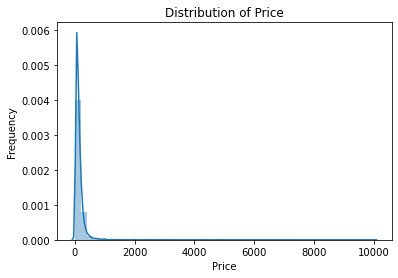

In [10]:
#histogram of the distribution of target 
graph = sns.distplot(df['price'], kde=True)
graph.set_xlabel('Price')
graph.set_ylabel('Frequency')
graph.set_title('Distribution of Price')
print("Standard Deviation of Target:", df['price'].std())
print("Mean of Target:", df['price'].mean())
print("Max of Target:", df['price'].max())
print("Min of Target:", df['price'].min())

In [11]:
#Most of the price is under the range 400
df = df[df["price"] < 400]
print(df['price'].count())

46907


C:\Users\zhaot\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Standard Deviation of Target: 76.02250426277205
Mean of Target: 125.09284328565033


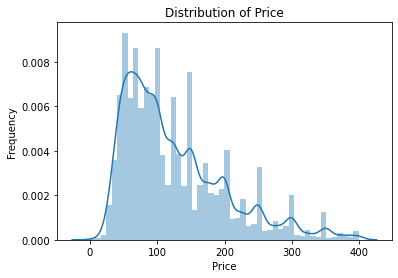

In [12]:
graph = sns.distplot(df["price"], kde=True)
graph.set_xlabel('Price')
graph.set_ylabel('Frequency')
graph.set_title('Distribution of Price')
print("Standard Deviation of Target:", df['price'].std())
print("Mean of Target:", df['price'].mean())


In [13]:
ava = px.scatter(df, x="availability_365", y=df["price"], template="none", hover_name= "availability_365",
                    title='Relationship between availability_365 and Price', trendline="ols", labels = {"y": "price"})
ava.show()

In [ ]:
review = px.scatter(df, x="reviews_per_month", y=df["price"], template="none", hover_name= "reviews_per_month",
                    title='Relationship between reviews_per_month and Price', trendline="ols", labels = {"y": "price"})
review.show()

[Text(0, 0.5, 'Num of Airbnb'),
 Text(0.5, 1.0, 'Num of Airbnb in each neighbourhood group')]

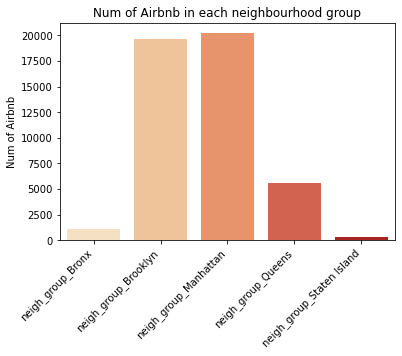

In [15]:
ngb = df[df['neigh_group_Bronx'] == 1]['price'].count()
ngbr = df[df['neigh_group_Brooklyn'] == 1]['price'].count()
ngm = df[df['neigh_group_Manhattan'] == 1]['price'].count()
ngq = df[df['neigh_group_Queens'] == 1]['price'].count()
ngs = df[df['neigh_group_Staten Island'] == 1]['price'].count()

ng = sns.barplot(x = ['neigh_group_Bronx', 'neigh_group_Brooklyn', 'neigh_group_Manhattan', "neigh_group_Queens", "neigh_group_Staten Island"],
                 y = [ngb, ngbr, ngm, ngq, ngs], palette = 'OrRd')
ng.set_xticklabels(ng.get_xticklabels(), rotation=45, horizontalalignment='right')
ng.set(ylabel = 'Num of Airbnb', title = "Num of Airbnb in each neighbourhood group")


# Models

In [16]:
x = df.drop("price", axis=1)
y = df["price"]

print(x.shape)
print(y.shape)

(46907, 235)
(46907,)


In [17]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.25)

print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)
print(x.shape)

(35180, 235)
(11727, 235)
(35180,)
(11727,)
(46907, 235)


In [18]:
def scale_train_test_x(train, test, scaler = None):
    if scaler is None:
        scaler = StandardScaler()
    scaler.fit(train)
    train = scaler.transform(train)
    test = scaler.transform(test)
    return train, test

# scale data
x_train_scaled, x_test_scaled = scale_train_test_x(x_train, x_test)

# Linear Regression & Ridge & Lasso Model

In [24]:
linear_g = LinearRegression().fit(x_train_scaled, y_train)
y_pred_train = linear_g.predict(x_train_scaled)
print("For training data of Linear Regression:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = linear_g.predict(x_test_scaled)
print()
print("For Testing data of Linear Regression:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

For training data of Linear Regression:
Mean Squared Error: 2876.068358805312
R2 square Score: 0.5045784437506105

For Testing data of Linear Regression:
Mean Squared Error: 4.216428084733843e+25
R2 square Score: -7.395932196765145e+21


In [25]:
ridge = Ridge().fit(x_train_scaled, y_train)

y_pred_train = ridge.predict(x_train_scaled)
print("For training data of Ridge:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = ridge.predict(x_test_scaled)
print()
print("For Testing data of Ridge:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

lamda = [0.05, 0.1, 1, 10, 100]
for i in lamda:
    ridge = Ridge(alpha=i).fit(x_train_scaled, y_train)
    pred = ridge.predict(x_train_scaled)
    mse = mean_squared_error(y_train, pred)
    r2 = r2_score(y_train, pred)
    print()
    print(f"The model performance for training set (alpha = {i})")
    print("--------------------------------------")
    print('MSE is {}'.format(mse))
    print('R2 is {}'.format(r2))
    pred = ridge.predict(x_test_scaled)
    mse = mean_squared_error(y_test, pred)
    r2 = r2_score(y_test, pred)
    print()
    print(f"The model performance for testing set (alpha = {i})")
    print("--------------------------------------")
    print('MSE is {}'.format(mse))
    print('R2 is {}'.format(r2))

For training data of Ridge:
Mean Squared Error: 2860.200478610868
R2 square Score: 0.507311789735327

For Testing data of Ridge:
Mean Squared Error: 2924.8877226170794
R2 square Score: 0.48695268020936133

The model performance for training set (lambda = 0.05)
--------------------------------------
MSE is 2860.200454686856
R2 is 0.5073117938563941

The model performance for testing set (lambda = 0.05)
--------------------------------------
MSE is 2924.899081158771
R2 is 0.4869506878356622

The model performance for training set (lambda = 0.1)
--------------------------------------
MSE is 2860.2004548673904
R2 is 0.507311793825296

The model performance for testing set (lambda = 0.1)
--------------------------------------
MSE is 2924.8984809681206
R2 is 0.48695079311361933

The model performance for training set (lambda = 1)
--------------------------------------
MSE is 2860.200478610868
R2 is 0.507311789735327

The model performance for testing set (lambda = 1)
------------------------

In [26]:
lasso = Lasso().fit(x_train_scaled, y_train)

y_pred_train = lasso.predict(x_train_scaled)
print("For training data of Lasso:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = lasso.predict(x_test_scaled)
print()
print("For Testing data of Lasso:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

lamda = [0.05, 0.1, 1, 10, 100]
for i in lamda:
    lasso = Lasso(alpha=i).fit(x_train_scaled, y_train)
    pred = lasso.predict(x_train_scaled)
    mse = mean_squared_error(y_train, pred)
    r2 = r2_score(y_train, pred)
    print()
    print(f"The model performance for training set (alpha = {i})")
    print("--------------------------------------")
    print('MSE is {}'.format(mse))
    print('R2 is {}'.format(r2))
    pred = lasso.predict(x_test_scaled)
    mse = mean_squared_error(y_test, pred)
    r2 = r2_score(y_test, pred)
    print()
    print(f"The model performance for testing set (alpha = {i})")
    print("--------------------------------------")
    print('MSE is {}'.format(mse))
    print('R2 is {}'.format(r2))

For training data of Lasso:
Mean Squared Error: 2952.779014079448
R2 square Score: 0.49136453243989

For Testing data of Lasso:
Mean Squared Error: 2981.3885867053605
R2 square Score: 0.47704200341236935

The model performance for training set (lambda = 0.05)
--------------------------------------
MSE is 2861.391958214025
R2 is 0.5071065495930234

The model performance for testing set (lambda = 0.05)
--------------------------------------
MSE is 2919.503219573257
R2 is 0.4878971625680092

The model performance for training set (lambda = 0.1)
--------------------------------------
MSE is 2864.1279032583802
R2 is 0.5066352651927284

The model performance for testing set (lambda = 0.1)
--------------------------------------
MSE is 2920.36529384269
R2 is 0.487745948253021

The model performance for training set (lambda = 1)
--------------------------------------
MSE is 2952.779014079448
R2 is 0.49136453243989

The model performance for testing set (lambda = 1)
-----------------------------

latitude : 191.23780888853042
longitude : 3601.034370330932
minimum_nights : 42.03910040766971
number_of_reviews : 55.17315195798474
reviews_per_month : 78.58653048707211
availability_365 : 227.34564753862333
neigh_group_Bronx : 297.5099550432409
neigh_group_Brooklyn : 1275.2824651401309
neigh_group_Manhattan : 4325.969843950098
neigh_group_Queens : 1016.7674778848802
neigh_group_Staten Island : 61.925351983875736
neigh_Allerton : 14.28831415100385
neigh_Arden Heights : 1.7748082409346757
neigh_Arrochar : 1.67189164674856
neigh_Arverne : 0.05636626204110776
neigh_Astoria : 91.67658587329322
neigh_Bath Beach : 6.689681082136119
neigh_Battery Park City : 16.868465278212746
neigh_Bay Ridge : 15.640273952696056
neigh_Bay Terrace : 0.6497545610867542
neigh_Bay Terrace, Staten Island : 0.1082179777147067
neigh_Baychester : 2.450405233992883
neigh_Bayside : 6.752510448917951
neigh_Bayswater : 1.7212504836142666
neigh_Bedford-Stuyvesant : 486.7442641639791
neigh_Belle Harbor : 2.98879069481547

C:\Users\zhaot\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:302: RuntimeWarning:

invalid value encountered in true_divide



28.633584489163457
neigh_Mill Basin : 2.0705439876409466
neigh_Morningside Heights : 12.678331477916343
neigh_Morris Heights : 4.067718675485393
neigh_Morris Park : 7.122342399376248
neigh_Morrisania : 4.691794499245685
neigh_Mott Haven : 10.828381612684149
neigh_Mount Eden : 2.353075272427917
neigh_Mount Hope : 7.195447580966077
neigh_Murray Hill : 251.95353523210255
neigh_Navy Yard : 0.8410309815059539
neigh_Neponsit : 11.589896525223049
neigh_New Brighton : 2.475439096222199
neigh_New Dorp : 0.7949880086634842
neigh_New Dorp Beach : 3.929065837950601
neigh_New Springville : 1.8334403994345179
neigh_NoHo : 71.02053152565404
neigh_Nolita : 97.77399411855846
neigh_North Riverdale : 3.991308893291196
neigh_Norwood : 10.903961513888767
neigh_Oakwood : 1.647637755962008
neigh_Olinville : 3.413456352207685
neigh_Ozone Park : 12.676381845046047
neigh_Park Slope : 31.87992035639846
neigh_Parkchester : 15.21172615226265
neigh_Pelham Bay : 1.2181854754451193
neigh_Pelham Gardens : 3.6940161504

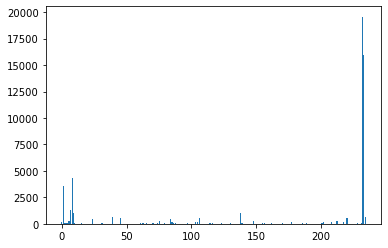

In [27]:
# feature selection
def select_features(X_train, y_train, X_test):
	# configure to select all features
	fs = SelectKBest(score_func=f_regression, k='all')
	# learn relationship from training data
	fs.fit(X_train, y_train)
	# transform train input data
	X_train_fs = fs.transform(X_train)
	# transform test input data
	X_test_fs = fs.transform(X_test)
	return X_train_fs, X_test_fs, fs
 
# feature selection
x_train_fs, x_test_fs, fs = select_features(x_train, y_train, x_test)
# what are scores for the features
for i in range(len(fs.scores_)):
	print(x_train.columns[i], ':', fs.scores_[i])
# plot the scores
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

In [28]:
#pick the features that importance greater than 1
num = 0
name = []
for i in range(len(fs.scores_)):
    if fs.scores_[i] >= 1:
        num += 1
        name.append(x_train.columns[i])
        print(x_train.columns[i], ':', fs.scores_[i])
        
print('Number of features that importance is greater than 1:', num)
print('Name of selected features:')
print(name)

latitude : 191.23780888853042
longitude : 3601.034370330932
minimum_nights : 42.03910040766971
number_of_reviews : 55.17315195798474
reviews_per_month : 78.58653048707211
availability_365 : 227.34564753862333
neigh_group_Bronx : 297.5099550432409
neigh_group_Brooklyn : 1275.2824651401309
neigh_group_Manhattan : 4325.969843950098
neigh_group_Queens : 1016.7674778848802
neigh_group_Staten Island : 61.925351983875736
neigh_Allerton : 14.28831415100385
neigh_Arden Heights : 1.7748082409346757
neigh_Arrochar : 1.67189164674856
neigh_Astoria : 91.67658587329322
neigh_Bath Beach : 6.689681082136119
neigh_Battery Park City : 16.868465278212746
neigh_Bay Ridge : 15.640273952696056
neigh_Baychester : 2.450405233992883
neigh_Bayside : 6.752510448917951
neigh_Bayswater : 1.7212504836142666
neigh_Bedford-Stuyvesant : 486.7442641639791
neigh_Belle Harbor : 2.9887906948154743
neigh_Belmont : 7.5123649414859655
neigh_Bensonhurst : 22.36248213109747
neigh_Bergen Beach : 1.2495683013091905
neigh_Boerum 

In [29]:
x_train_selected_li = x_train[name]
x_test_selected_li = x_test[name]

x_train_scaled_se, x_test_scaled_se = scale_train_test_x(x_train_selected_li, x_test_selected_li)

print("When only using the features whose importance is greater than 1")
print()
linear_g = LinearRegression().fit(x_train_scaled_se, y_train)
y_pred_train = linear_g.predict(x_train_scaled_se)
print("For training data of Linear Regression:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = linear_g.predict(x_test_scaled_se)
print()
print("For Testing data of Linear Regression:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

When only using the features whose importance is greater than 1

For training data of Linear Regression:
Mean Squared Error: 2867.014756142649
R2 square Score: 0.5061379859315422

For Testing data of Linear Regression:
Mean Squared Error: 2924.9039400899014
R2 square Score: 0.48694983554257265


In [30]:
#pick the features that importance greater than 5
num = 0
name = []
for i in range(len(fs.scores_)):
    if fs.scores_[i] >= 5:
        num += 1
        name.append(x_train.columns[i])
        print(x_train.columns[i], ':', fs.scores_[i])
        
print('Number of features that importance is greater than 5:', num)
print('Name of selected features:')
print(name)

latitude : 191.23780888853042
longitude : 3601.034370330932
minimum_nights : 42.03910040766971
number_of_reviews : 55.17315195798474
reviews_per_month : 78.58653048707211
availability_365 : 227.34564753862333
neigh_group_Bronx : 297.5099550432409
neigh_group_Brooklyn : 1275.2824651401309
neigh_group_Manhattan : 4325.969843950098
neigh_group_Queens : 1016.7674778848802
neigh_group_Staten Island : 61.925351983875736
neigh_Allerton : 14.28831415100385
neigh_Astoria : 91.67658587329322
neigh_Bath Beach : 6.689681082136119
neigh_Battery Park City : 16.868465278212746
neigh_Bay Ridge : 15.640273952696056
neigh_Bayside : 6.752510448917951
neigh_Bedford-Stuyvesant : 486.7442641639791
neigh_Belmont : 7.5123649414859655
neigh_Bensonhurst : 22.36248213109747
neigh_Boerum Hill : 13.153951746851826
neigh_Borough Park : 65.99341455608547
neigh_Briarwood : 11.703832592073628
neigh_Brighton Beach : 8.598822303242573
neigh_Bronxdale : 11.5383778505909
neigh_Brooklyn Heights : 27.526507964368975
neigh_B

In [31]:
x_train_selected_li = x_train[name]
x_test_selected_li = x_test[name]

x_train_scaled_se, x_test_scaled_se = scale_train_test_x(x_train_selected_li, x_test_selected_li)

print("When only using the features whose importance is greater than 5")
print()
linear_g = LinearRegression().fit(x_train_scaled_se, y_train)
y_pred_train = linear_g.predict(x_train_scaled_se)
print("For training data of Linear Regression:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = linear_g.predict(x_test_scaled_se)
print()
print("For Testing data of Linear Regression:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

When only using the features whose importance is greater than 5

For training data of Linear Regression:
Mean Squared Error: 2884.3344338451457
R2 square Score: 0.5031545583454633

For Testing data of Linear Regression:
Mean Squared Error: 2936.079416925272
R2 square Score: 0.4849895727969521


In [32]:
#pick the features that importance greater than 10
num = 0
name = []
for i in range(len(fs.scores_)):
    if fs.scores_[i] >= 10:
        num += 1
        name.append(x_train.columns[i])
        print(x_train.columns[i], ':', fs.scores_[i])
        
print('Number of features that importance is greater than 10:', num)
print('Name of selected features:')
print(name)

latitude : 191.23780888853042
longitude : 3601.034370330932
minimum_nights : 42.03910040766971
number_of_reviews : 55.17315195798474
reviews_per_month : 78.58653048707211
availability_365 : 227.34564753862333
neigh_group_Bronx : 297.5099550432409
neigh_group_Brooklyn : 1275.2824651401309
neigh_group_Manhattan : 4325.969843950098
neigh_group_Queens : 1016.7674778848802
neigh_group_Staten Island : 61.925351983875736
neigh_Allerton : 14.28831415100385
neigh_Astoria : 91.67658587329322
neigh_Battery Park City : 16.868465278212746
neigh_Bay Ridge : 15.640273952696056
neigh_Bedford-Stuyvesant : 486.7442641639791
neigh_Bensonhurst : 22.36248213109747
neigh_Boerum Hill : 13.153951746851826
neigh_Borough Park : 65.99341455608547
neigh_Briarwood : 11.703832592073628
neigh_Bronxdale : 11.5383778505909
neigh_Brooklyn Heights : 27.526507964368975
neigh_Brownsville : 21.219983079194378
neigh_Bushwick : 666.0732380954412
neigh_Canarsie : 15.455031654379539
neigh_Carroll Gardens : 21.721552814424072
n

In [33]:
x_train_selected_li = x_train[name]
x_test_selected_li = x_test[name]

x_train_scaled_se, x_test_scaled_se = scale_train_test_x(x_train_selected_li, x_test_selected_li)

print("When only using the features whose importance is greater than 10")
print()
linear_g = LinearRegression().fit(x_train_scaled_se, y_train)
y_pred_train = linear_g.predict(x_train_scaled_se)
print("For training data of Linear Regression:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = linear_g.predict(x_test_scaled_se)
print()
print("For Testing data of Linear Regression:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

When only using the features whose importance is greater than 10

For training data of Linear Regression:
Mean Squared Error: 2905.677687374679
R2 square Score: 0.49947804354822145

For Testing data of Linear Regression:
Mean Squared Error: 2954.95202552192
R2 square Score: 0.4816791752103725


# Decision Tree Regressor

In [19]:
d_tree_re = DecisionTreeRegressor().fit(x_train_scaled, y_train)

y_pred_train = d_tree_re.predict(x_train_scaled)
print("For training data of Decision Tree Regressor:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = d_tree_re.predict(x_test_scaled)
print()
print("For Testing data of Decision Tree Regressor:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

print()
depths = [x for x in range(1, 20) if x % 2 != 0]
cv_scores = []
for d in depths:
    tree = DecisionTreeRegressor(max_depth = d).fit(x_train_scaled, y_train)
    scores = cross_val_score(tree, x, y)#, cv=10, scoring='accuracy')
    cv_scores.append(scores.mean())

MSE = [1-x for x in cv_scores]
optimal_d_index = MSE.index(min(MSE))
optimal_d = depths[optimal_d_index]
print("The best max_depth value is ", optimal_d)
print()

tree = DecisionTreeRegressor(max_depth = optimal_d).fit(x_train_scaled, y_train)
preds = tree.predict(x_test_scaled)

y_pred_train = tree.predict(x_train_scaled)
print("For training data of Decision Tree Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = tree.predict(x_test_scaled)
print()
print("For Testing data of Decision Tree Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

    

For training data of Decision Tree Regressor:
Mean Squared Error: 0.0
R2 square Score: 1.0

For Testing data of Decision Tree Regressor:
Mean Squared Error: 5084.565191438561
R2 square Score: 0.11242669591703314

The best max_depth value is  7

For training data of Decision Tree Regressor with optimal max_depth:
Mean Squared Error: 2663.311956361203
R2 square Score: 0.540505063370209

For Testing data of Decision Tree Regressor with optimal max_depth:
Mean Squared Error: 2843.2364373706782
R2 square Score: 0.5036781585069642


In [20]:
#feature selection of decision tree regressor model
importances = pd.DataFrame({'feature':x_train.columns,'importance':np.round(d_tree_re.feature_importances_,3)})
importances = importances.sort_values('importance',ascending=False)
t_name = []
t_num = 0 
for i in range(len(importances)):
    if importances['importance'][i] > 0: 
        t_num += 1
        t_name.append(importances['feature'][i])
        print(importances['feature'][i], ":", importances['importance'][i])

print('Number of features that importance is greater than 0:', t_num)
print('Name of selected features:')
print(t_name)

latitude : 0.161
longitude : 0.185
minimum_nights : 0.051
number_of_reviews : 0.051
reviews_per_month : 0.065
availability_365 : 0.077
neigh_group_Queens : 0.001
neigh_Astoria : 0.001
neigh_Bedford-Stuyvesant : 0.001
neigh_Bushwick : 0.001
neigh_Chelsea : 0.002
neigh_Crown Heights : 0.001
neigh_East Harlem : 0.001
neigh_East Village : 0.002
neigh_Financial District : 0.001
neigh_Flushing : 0.001
neigh_Gramercy : 0.001
neigh_Greenpoint : 0.001
neigh_Greenwich Village : 0.001
neigh_Hell's Kitchen : 0.002
neigh_Kew Gardens Hills : 0.001
neigh_Long Island City : 0.001
neigh_Lower East Side : 0.001
neigh_Midtown : 0.007
neigh_NoHo : 0.001
neigh_Nolita : 0.001
neigh_Prospect-Lefferts Gardens : 0.001
neigh_Ridgewood : 0.001
neigh_Theater District : 0.001
neigh_Tribeca : 0.001
neigh_Upper East Side : 0.002
neigh_Upper West Side : 0.001
neigh_Williamsburg : 0.001
Entire home/apt : 0.357
Private room : 0.003
Shared room : 0.001
Number of features that importance is greater than 0: 36
Name of sel

[Text(0, 0.5, 'Importance'),
 Text(0.5, 1.0, 'Importance of each feature of Decision Tree Regressor Model')]

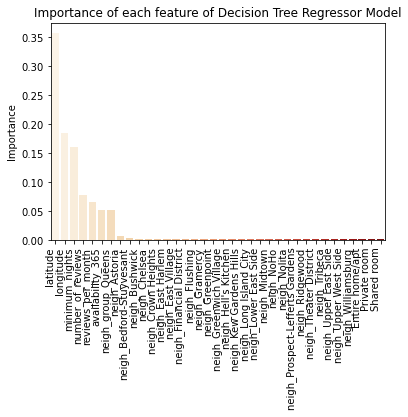

In [23]:
dt_df = importances[importances['feature'].isin(t_name)]
dt = sns.barplot(x = t_name, y = dt_df['importance'], palette = 'OrRd')
dt.set_xticklabels(dt.get_xticklabels(), rotation=90, horizontalalignment='right')
dt.set(ylabel = 'Importance', title = "Importance of each feature of Decision Tree Regressor Model")

In [124]:
x_train_selected_tr = x_train[t_name]
x_test_selected_tr = x_test[t_name]

x_train_scaled_te, x_test_scaled_te = scale_train_test_x(x_train_selected_tr, x_test_selected_tr)

print("With selected feature whose importance is greater than 0")
print()

tree = DecisionTreeRegressor(max_depth = optimal_d).fit(x_train_scaled_te, y_train)

y_pred_train = tree.predict(x_train_scaled_te)
print("For training data of Decision Tree Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = tree.predict(x_test_scaled_te)
print()
print("For Testing data of Decision Tree Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))


With selected feature whose importance is greater than 0

For training data of Decision Tree Regressor with optimal max_depth:
Mean Squared Error: 2690.074729206404
R2 square Score: 0.5335694209635925

For Testing data of Decision Tree Regressor with optimal max_depth:
Mean Squared Error: 2835.8183084467064
R2 square Score: 0.5123237788033089


In [125]:
t_name = []
t_num = 0 
for i in range(len(importances)):
    if importances['importance'][i] > 0.05: 
        t_num += 1
        t_name.append(importances['feature'][i])
        print(importances['feature'][i], ":", importances['importance'][i])

print('Number of features that importance is greater than 0.05:', t_num)
print('Name of selected features:')
print(t_name)

latitude : 0.164
longitude : 0.186
reviews_per_month : 0.066
availability_365 : 0.078
Entire home/apt : 0.356
Number of features that importance is greater than 0.05: 5
Name of selected features:
['latitude', 'longitude', 'reviews_per_month', 'availability_365', 'Entire home/apt']


In [126]:
x_train_selected_tr = x_train[t_name]
x_test_selected_tr = x_test[t_name]

x_train_scaled_te, x_test_scaled_te = scale_train_test_x(x_train_selected_tr, x_test_selected_tr)

print("With selected feature whose importance is greater than 0.05")
print()

tree = DecisionTreeRegressor(max_depth = optimal_d).fit(x_train_scaled_te, y_train)

y_pred_train = tree.predict(x_train_scaled_te)
print("For training data of Decision Tree Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = tree.predict(x_test_scaled_te)
print()
print("For Testing data of Decision Tree Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

With selected feature whose importance is greater than 0.05

For training data of Decision Tree Regressor with optimal max_depth:
Mean Squared Error: 2768.7014547946524
R2 square Score: 0.5199363762211207

For Testing data of Decision Tree Regressor with optimal max_depth:
Mean Squared Error: 2913.9406858885586
R2 square Score: 0.49888905849408993


# Random Forest Regressor

In [23]:
rfr = RandomForestRegressor().fit(x_train_scaled, y_train)

y_pred_train = rfr.predict(x_train_scaled)
print("For training set:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = rfr.predict(x_test_scaled)
print()
print("For Testing set:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

For training set:
Mean Squared Error: 366.2656790535716
R2 square Score: 0.9359750972791295

For Testing set:
Mean Squared Error: 2752.2905121902972
R2 square Score: 0.5378199677275428


In [27]:
#feature selection of decision tree regressor model
importances = pd.DataFrame({'feature':x_train.columns,'importance':np.round(rfr.feature_importances_,3)})
importances = importances.sort_values('importance',ascending=False)


In [29]:
r_name = []
r_num = 0 
for i in range(len(importances)):
    if importances['importance'][i] > 0: 
        r_num += 1
        r_name.append(importances['feature'][i])
        print(importances['feature'][i], ":", importances['importance'][i])

print('Number of features that importance is greater than 0:', r_num)
print('Name of selected features:')
print(r_name)

latitude : 0.151
longitude : 0.177
minimum_nights : 0.05
number_of_reviews : 0.054
reviews_per_month : 0.064
availability_365 : 0.08
neigh_group_Brooklyn : 0.001
neigh_group_Manhattan : 0.01
neigh_group_Queens : 0.001
neigh_Astoria : 0.001
neigh_Bedford-Stuyvesant : 0.001
neigh_Bushwick : 0.001
neigh_Chelsea : 0.001
neigh_Chinatown : 0.001
neigh_Clason Point : 0.001
neigh_Clinton Hill : 0.001
neigh_Crown Heights : 0.001
neigh_East Harlem : 0.001
neigh_East Village : 0.001
neigh_Financial District : 0.001
neigh_Gramercy : 0.001
neigh_Greenpoint : 0.001
neigh_Greenwich Village : 0.001
neigh_Harlem : 0.001
neigh_Hell's Kitchen : 0.001
neigh_Jamaica : 0.001
neigh_Kew Gardens Hills : 0.001
neigh_Kips Bay : 0.001
neigh_Long Island City : 0.001
neigh_Lower East Side : 0.001
neigh_Midtown : 0.006
neigh_Murray Hill : 0.001
neigh_NoHo : 0.001
neigh_Nolita : 0.001
neigh_SoHo : 0.001
neigh_Theater District : 0.001
neigh_Tribeca : 0.001
neigh_Upper East Side : 0.001
neigh_Upper West Side : 0.001
ne

[Text(0, 0.5, 'Importance'),
 Text(0.5, 1.0, 'Importance of each feature of Random Forest Regressor Model')]

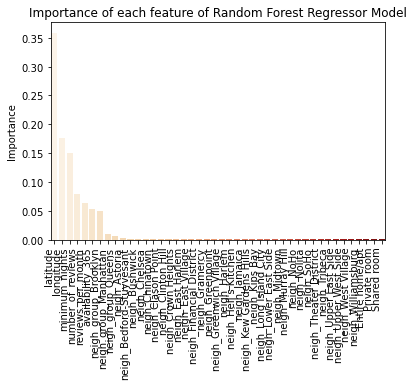

In [35]:
fi_df = importances[importances['feature'].isin(r_name)]
fi = sns.barplot(x = r_name, y = fi_df['importance'], palette = 'OrRd')
fi.set_xticklabels(fi.get_xticklabels(), rotation=90, horizontalalignment='right')
fi.set(ylabel = 'Importance', title = "Importance of each feature of Random Forest Regressor Model")

In [37]:
x_train_selected_rf = x_train[r_name]
x_test_selected_rf = x_test[r_name]

x_train_scaled_rf, x_test_scaled_rf = scale_train_test_x(x_train_selected_rf, x_test_selected_rf)

print("When only using the features whose importance is greater than 0")
print()
rfr = RandomForestRegressor().fit(x_train_scaled_rf, y_train)
y_pred_train = rfr.predict(x_train_scaled_rf)
print("For training data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = rfr.predict(x_test_scaled_rf)
print()
print("For Testing data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

When only using the features whose importance is greater than 0

For training data of Random Forest Regressor:
Mean Squared Error: 364.638783940607
R2 square Score: 0.93625948592732

For Testing data of Random Forest Regressor:
Mean Squared Error: 2739.2957308443006
R2 square Score: 0.5400021241660674


In [40]:
estimators = [10, 100, 150]
for e in estimators:
    print("When n_estimators =", e)
    rfr = RandomForestRegressor(n_estimators=e).fit(x_train_scaled_rf, y_train)
    y_pred_train = rfr.predict(x_train_scaled_rf)
    print("For training data of Random Forest Regressor:")
    print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
    print("R2 square Score:", r2_score(y_train, y_pred_train))

    y_pred_test = rfr.predict(x_test_scaled_rf)
    print("For Testing data of Random Forest Regressor:")
    print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
    print("R2 square Score:", r2_score(y_test, y_pred_test))
    print()

When n_estimators = 10
For training data of Random Forest Regressor:
Mean Squared Error: 506.65430734002905
R2 square Score: 0.911434528006074
For Testing data of Random Forest Regressor:
Mean Squared Error: 2944.905882152298
R2 square Score: 0.5054749163926953

When n_estimators = 100
For training data of Random Forest Regressor:
Mean Squared Error: 367.0637892105646
R2 square Score: 0.9358355840020623
For Testing data of Random Forest Regressor:
Mean Squared Error: 2743.623311800404
R2 square Score: 0.5392754125427506

When n_estimators = 150
For training data of Random Forest Regressor:
Mean Squared Error: 360.53893244834654
R2 square Score: 0.9369761585722708
For Testing data of Random Forest Regressor:
Mean Squared Error: 2728.075971965696
R2 square Score: 0.5418862088939096



In [41]:
print('start')
rfr = RandomForestRegressor(n_estimators=150, max_depth=3).fit(x_train_scaled_rf, y_train)

y_pred_train = rfr.predict(x_train_scaled_rf)
print("For training data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = rfr.predict(x_test_scaled_rf)
print("For Testing data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))
print()

rfr = RandomForestRegressor(n_estimators=150, max_depth=5).fit(x_train_scaled_rf, y_train)

y_pred_train = rfr.predict(x_train_scaled_rf)
print("For training data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = rfr.predict(x_test_scaled_rf)
print("For Testing data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))
print()

rfr = RandomForestRegressor(n_estimators=150, max_depth=7).fit(x_train_scaled_rf, y_train)

y_pred_train = rfr.predict(x_train_scaled_rf)
print("For training data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = rfr.predict(x_test_scaled_rf)
print("For Testing data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))
print()

start
For training data of Random Forest Regressor:
Mean Squared Error: 3065.165151009192
R2 square Score: 0.4641952226485797
For Testing data of Random Forest Regressor:
Mean Squared Error: 3294.6568132329007
R2 square Score: 0.44674278186758154

For training data of Random Forest Regressor:
Mean Squared Error: 2782.521644579851
R2 square Score: 0.5136025901381703
For Testing data of Random Forest Regressor:
Mean Squared Error: 3022.0722591468984
R2 square Score: 0.4925167063302951

For training data of Random Forest Regressor:
Mean Squared Error: 2520.337976420043
R2 square Score: 0.5594334850566032
For Testing data of Random Forest Regressor:
Mean Squared Error: 2853.0184838091727
R2 square Score: 0.5209051627796805



In [42]:
rfr = RandomForestRegressor(n_estimators=150, max_depth=9).fit(x_train_scaled_rf, y_train)

y_pred_train = rfr.predict(x_train_scaled_rf)
print("For training data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = rfr.predict(x_test_scaled_rf)
print("For Testing data of Random Forest Regressor:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))
print()

For training data of Random Forest Regressor:
Mean Squared Error: 2243.7686182054968
R2 square Score: 0.607779063875278
For Testing data of Random Forest Regressor:
Mean Squared Error: 2760.615828531171
R2 square Score: 0.5364219339959797



# Gradient Boosting Regressor

In [30]:
gbr = GradientBoostingRegressor().fit(x_train_scaled, y_train)

y_pred_train = gbr.predict(x_train_scaled)
print("For training set:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = gbr.predict(x_test_scaled)
print()
print("For Testing set:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

For training set:
Mean Squared Error: 2619.525901376018
R2 square Score: 0.5480593682696526

For Testing set:
Mean Squared Error: 2671.551681046296
R2 square Score: 0.5336478413990422


In [31]:
#feature selection of decision tree regressor model
importances = pd.DataFrame({'feature':x_train.columns,'importance':np.round(gbr.feature_importances_,3)})
importances = importances.sort_values('importance',ascending=False)
importances

,feature,importance
232,Entire home/apt,0.649
1,longitude,0.127
0,latitude,0.081
5,availability_365,0.041
8,neigh_group_Manhattan,0.026
...,...,...
90,neigh_Forest Hills,0.000
91,neigh_Fort Greene,0.000
92,neigh_Fort Hamilton,0.000
93,neigh_Fort Wadsworth,0.000


In [32]:
#feature selection of gradient Boosting Regressor
g_name = []
g_num = 0 
for i in range(len(importances)):
    if importances['importance'][i] > 0: 
        g_num += 1
        g_name.append(importances['feature'][i])
        print(importances['feature'][i], ":", importances['importance'][i])

print('Number of features that importance is greater than 0:', g_num)
print('Name of selected features:')
print(g_name)

latitude : 0.081
longitude : 0.127
minimum_nights : 0.025
number_of_reviews : 0.011
reviews_per_month : 0.007
availability_365 : 0.041
neigh_group_Manhattan : 0.026
neigh_Chelsea : 0.001
neigh_East Village : 0.001
neigh_Lower East Side : 0.001
neigh_Midtown : 0.011
neigh_Tribeca : 0.001
neigh_Upper East Side : 0.001
neigh_Williamsburg : 0.008
Entire home/apt : 0.649
Private room : 0.001
Shared room : 0.004
Number of features that importance is greater than 0: 17
Name of selected features:
['latitude', 'longitude', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'availability_365', 'neigh_group_Manhattan', 'neigh_Chelsea', 'neigh_East Village', 'neigh_Lower East Side', 'neigh_Midtown', 'neigh_Tribeca', 'neigh_Upper East Side', 'neigh_Williamsburg', 'Entire home/apt', 'Private room', 'Shared room']


[Text(0, 0.5, 'Importance'),
 Text(0.5, 1.0, 'Importance of each feature of Gradient Boosting Regressor')]

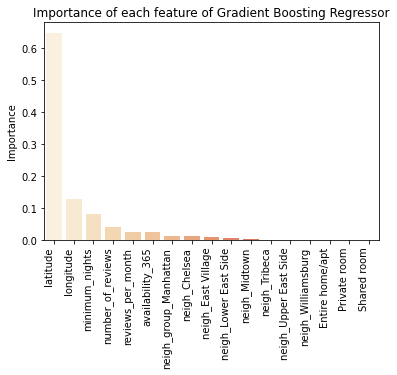

In [33]:
gb_df = importances[importances['feature'].isin(g_name)]
gb = sns.barplot(x = g_name, y = gb_df['importance'], palette = 'OrRd')
gb.set_xticklabels(gb.get_xticklabels(), rotation=90, horizontalalignment='right')
gb.set(ylabel = 'Importance', title = "Importance of each feature of Gradient Boosting Regressor")

In [34]:
x_train_selected_gb = x_train[g_name]
x_test_selected_gb = x_test[g_name]

x_train_scaled_gb, x_test_scaled_gb = scale_train_test_x(x_train_selected_gb, x_test_selected_gb)

print("When only using the features whose importance is greater than 0")
print()
gbr = GradientBoostingRegressor().fit(x_train_scaled_gb, y_train)
y_pred_train = gbr.predict(x_train_scaled_gb)
print("For training data of Gradient Boosting Regressor:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = gbr.predict(x_test_scaled_gb)
print()
print("For Testing data of Gradient Boosting Regressor:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

When only using the features whose importance is greater than 0

For training data of Gradient Boosting Regressor:
Mean Squared Error: 2624.9477918480356
R2 square Score: 0.5471239422813814

For Testing data of Gradient Boosting Regressor:
Mean Squared Error: 2668.0575429389814
R2 square Score: 0.5342577861215629


In [31]:
l_rate = [0.05, 0.01, 0.1, 1]
estimators = [10, 100, 1000]
for l in l_rate:
    for e in estimators:
        print("When learning_rate =", l, ", n_estimators =", e)
        gbr = GradientBoostingRegressor(n_estimators=e, learning_rate=l).fit(x_train_scaled_gb, y_train)
        y_pred_train = gbr.predict(x_train_scaled_gb)
        print("For training data of Gradient Boosting Regressor:")
        print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
        print("R2 square Score:", r2_score(y_train, y_pred_train))

        y_pred_test = gbr.predict(x_test_scaled_gb)
        print("For Testing data of Gradient Boosting Regressor:")
        print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
        print("R2 square Score:", r2_score(y_test, y_pred_test))
        print()
        

When learning_rate = 0.05 , n_estimators = 10
For training data of Gradient Boosting Regressor:
Mean Squared Error: 4048.111201356083
R2 square Score: 0.29515131518408433
For Testing data of Gradient Boosting Regressor:
Mean Squared Error: 4161.19402846465
R2 square Score: 0.2931863238609155

When learning_rate = 0.05 , n_estimators = 100
For training data of Gradient Boosting Regressor:
Mean Squared Error: 2713.940045080558
R2 square Score: 0.5274544160734845
For Testing data of Gradient Boosting Regressor:
Mean Squared Error: 2802.4287167489374
R2 square Score: 0.5239839983780077

When learning_rate = 0.05 , n_estimators = 1000
For training data of Gradient Boosting Regressor:
Mean Squared Error: 2403.2616611867243
R2 square Score: 0.581549088723521
For Testing data of Gradient Boosting Regressor:
Mean Squared Error: 2654.4948229245806
R2 square Score: 0.5491118099158279

When learning_rate = 0.01 , n_estimators = 10
For training data of Gradient Boosting Regressor:
Mean Squared Erro

In [29]:
print("start")
gdr = GradientBoostingRegressor(max_depth = 3, n_estimators=100, learning_rate=0.1).fit(x_train_scaled_gb, y_train)

y_pred_train = gdr.predict(x_train_scaled_gb)
print("For training data of Gradient Boosting Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = gdr.predict(x_test_scaled_gb)
print()
print("For Testing data of Gradient Boosting Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

gdr = GradientBoostingRegressor(max_depth = 5, n_estimators=100, learning_rate=0.1).fit(x_train_scaled_gb, y_train)

y_pred_train = gdr.predict(x_train_scaled_gb)
print("For training data of Gradient Boosting Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = gdr.predict(x_test_scaled_gb)
print()
print("For Testing data of Gradient Boosting Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

gdr = GradientBoostingRegressor(max_depth = 7, n_estimators=100, learning_rate=0.1).fit(x_train_scaled_gb, y_train)

y_pred_train = gdr.predict(x_train_scaled_gb)
print("For training data of Gradient Boosting Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = gdr.predict(x_test_scaled_gb)
print()
print("For Testing data of Gradient Boosting Regressor with optimal max_depth:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

start
For training data of Gradient Boosting Regressor with optimal max_depth:
Mean Squared Error: 2619.1180930210594
R2 square Score: 0.5481297264842699

For Testing data of Gradient Boosting Regressor with optimal max_depth:
Mean Squared Error: 2665.198651172627
R2 square Score: 0.5347568407930129
For training data of Gradient Boosting Regressor with optimal max_depth:
Mean Squared Error: 2373.587835381346
R2 square Score: 0.5904904833251616

For Testing data of Gradient Boosting Regressor with optimal max_depth:
Mean Squared Error: 2597.3484699956953
R2 square Score: 0.5466009232705549
For training data of Gradient Boosting Regressor with optimal max_depth:
Mean Squared Error: 1998.643940570896
R2 square Score: 0.6551786700672968

For Testing data of Gradient Boosting Regressor with optimal max_depth:
Mean Squared Error: 2590.4466196614303
R2 square Score: 0.5478057260166744


# MLP Regressor - Neural Network

In [44]:
mlp = MLPRegressor(max_iter = 1000).fit(x_train_scaled, y_train)

y_pred_train = mlp.predict(x_train_scaled)
print("For training data of MLP:")
print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
print("R2 square Score:", r2_score(y_train, y_pred_train))

y_pred_test = mlp.predict(x_test_scaled)
print()
print("For Testing data of MLP:")
print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
print("R2 square Score:", r2_score(y_test, y_pred_test))

For training data of MLP:
Mean Squared Error: 2458.7310858996025
R2 square Score: 0.5702026490762808

For Testing data of MLP:
Mean Squared Error: 2911.8432558919003
R2 square Score: 0.5110269777046685


In [34]:
l_rate = [0.001, 0.05, 0.01, 0.1, 1]
hidden = [100, 150, 200]
for l in l_rate:
    for h in hidden:
        print("When hidden_layer_size =", h, "learning_rate =", l)
        mlp = MLPRegressor(max_iter = 1000, hidden_layer_sizes=h, learning_rate_init=l).fit(x_train_scaled, y_train)
        y_pred_train = mlp.predict(x_train_scaled)
        print("For training data of MLP:")
        print("Mean Squared Error:", mean_squared_error (y_train, y_pred_train))
        print("R2 square Score:", r2_score(y_train, y_pred_train))

        y_pred_test = mlp.predict(x_test_scaled)
        print()
        print("For Testing data of MLP:")
        print("Mean Squared Error:", mean_squared_error (y_test, y_pred_test))
        print("R2 square Score:", r2_score(y_test, y_pred_test))

When hidden_layer_size = 100 learning_rate = 0.001
For training data of MLP:
Mean Squared Error: 2445.2851084079684
R2 square Score: 0.57878367175384

For Testing data of MLP:
Mean Squared Error: 2780.400535037232
R2 square Score: 0.5122968203480469
When hidden_layer_size = 150 learning_rate = 0.001
For training data of MLP:
Mean Squared Error: 2367.9812372174815
R2 square Score: 0.5920997683800002

For Testing data of MLP:
Mean Squared Error: 2826.235260462847
R2 square Score: 0.5042570645478102
When hidden_layer_size = 200 learning_rate = 0.001
For training data of MLP:
Mean Squared Error: 2428.3769421141847
R2 square Score: 0.5816962138124959

For Testing data of MLP:
Mean Squared Error: 2797.8915328526004
R2 square Score: 0.5092287676907608
When hidden_layer_size = 100 learning_rate = 0.05
For training data of MLP:
Mean Squared Error: 2669.437977470269
R2 square Score: 0.5401718762836032

For Testing data of MLP:
Mean Squared Error: 2806.7548129812453
R2 square Score: 0.50767408164